In [2]:
%run '../dynamo_helper_functions.ipynb'

/tmp/ipykernel_1002698/3777615979.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


['/net/capricorn/home/xing/soh29/.conda/envs/dynamo_06_2024/lib/python3.8/site-packages/dynamo']


package,umap-learn,trimap,tqdm,statsmodels,setuptools,seaborn,scipy,scikit-learn,python-igraph,pynndescent,pre-commit,pandas,numpy,numdifftools,numba,networkx,matplotlib,loompy,hdbscan,dynamo-release,cvxopt,colorcet
version,0.5.6,1.1.4,4.66.4,0.14.1,70.1.0,0.13.2,1.10.1,1.3.2,0.11.5,0.5.13,3.5.0,1.2.0,1.23.0,0.9.41,0.51.2,3.1,3.7.5,3.0.7,0.8.37,1.0.0,1.3.2,3.1.0


In [1]:
import numpy as np
from sklearn.datasets import make_swiss_roll
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import pairwise_distances
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.optimize import differential_evolution
import matplotlib.animation as animation
from sklearn.decomposition import PCA 
import pandas as pd
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import plotly
import umap
import plotly.figure_factory as ff
import phate
import scprep
import dynamo as dyn
from scipy import sparse as sp
from sklearn.utils import sparsefuncs
from pydiffmap import diffusion_map as dm
import plotly.express as px

/net/capricorn/home/xing/soh29/.conda/envs/dynamo_06_2024/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Functions

In [2]:
def create_plotly_colordict(cmap, num):
    cm = plt.get_cmap(cmap, num)
    toReturn = []
    for i in range(num):
        r = str(cm(i)[0])
        g = str(cm(i)[1])
        b = str(cm(i)[2])
        toReturn.append('rgb('+r+","+g+","+b+")")
    return toReturn

In [3]:
def forward_coord(x1, y1, r):
    dx = 0.5
    if (y1 == 0) | (abs(y1) < 0.5 * 10**(-5)):
        if x1 == 1:
            return x1, -0.5
        else:
            return x1, 0.5
    #m_t = -(x1 - h) / (y1 - k)
    m_t = -(x1) / (y1)
    if y1 > 0:
        x_tangent = x1 + dx
        y_tangent = m_t * (x_tangent - x1) + y1
    else:
        x_tangent = x1 - dx
        y_tangent = m_t * (x_tangent - x1) + y1
    return x_tangent, y_tangent

In [4]:
def before_coord(x1, y1, r):
    dx = 0.5
    if (y1 == 0) | (abs(y1) < 0.5 * 10**(-5)):
        if x1 == 1:
            return x1, 0.5
        else:
            return x1, -0.5
    #m_t = -(x1 - h) / (y1 - k)
    m_t = -(x1) / (y1)
    if y1 > 0:
        x_tangent = x1 - dx
        y_tangent = m_t * (x_tangent - x1) + y1
    else:
        x_tangent = x1 + dx
        y_tangent = m_t * (x_tangent - x1) + y1
    return x_tangent, y_tangent

In [5]:
def before_coord_1_unit(x1, y1, r):
    #dx = 0.5
    if (y1 == 0) | (abs(y1) < 0.5 * 10**(-5)):
        if x1 == 1:
            return np.array([x1, 1])
        else:
            return np.array([x1, -1])
    #m_t = -(x1 - h) / (y1 - k)
    m_t = -(x1) / (y1)
    direction_vector = np.array([1, m_t])
    normalized_direction_vector = direction_vector / np.linalg.norm(direction_vector)
    #print(x1, y1)
    #print(normalized_direction_vector)
    if y1 > 0:
        toReturn = np.array([x1, y1]) - normalized_direction_vector
        #x_tangent = x1 - dx
        #y_tangent = m_t * (x_tangent - x1) + y1
    else:
        toReturn = np.array([x1, y1]) + normalized_direction_vector
        #x_tangent = x1 + dx
        #y_tangent = m_t * (x_tangent - x1) + y1
    return toReturn

In [6]:
def after_coord_1_unit(x1, y1, r):
    #dx = 0.5
    x1 = np.round(x1, 2)
    y1 = np.round(y1, 2)
    if (y1 == 0) | (abs(y1) < 1 * 10**(-2)):
        if x1 == 1:
            return np.array([0, -1])
        else:
            return np.array([0, 1])
    if (x1 == 0) | (abs(x1) < 1 * 10**(-2)):
        if y1 == 1:
            return np.array([1, 0])
        else:
            return np.array([-1, 0])
    m_t = -(x1) / (y1)
    direction_vector = np.array([1, m_t])
    normalized_direction_vector = direction_vector / np.linalg.norm(direction_vector)
    if y1 > 0:
        toReturn = normalized_direction_vector
        #toReturn = np.array([x1, y1]) + normalized_direction_vector
    else:
        toReturn = -normalized_direction_vector
        #toReturn = np.array([x1, y1]) - normalized_direction_vector
    return toReturn

In [7]:
def after_coord_var_unit(x1, y1, r):
    #dx = 0.5
    x1 = np.round(x1, 2)
    y1 = np.round(y1, 2)
    if (y1 == 0) | (abs(y1) < 1 * 10**(-2)):
        if x1 == 1: # (1,0)
            return np.array([0, -0.5])
        else: # (-1,0)
            return np.array([0, 0.5])
    if (x1 == 0) | (abs(x1) < 1 * 10**(-2)):
        if y1 == 1: # (0,1)
            return np.array([2, 0])
        else: # (0,-1)
            return np.array([-2, 0])
    m_t = -(x1) / (y1)
    
    direction_vector = np.array([1, m_t])
    normalized_direction_vector = direction_vector / np.linalg.norm(direction_vector)
    if x1 > 0:
        if y1 > 0 :
            toReturn = 2*normalized_direction_vector
        else:
            toReturn = -0.5*normalized_direction_vector
    else:
        if y1 > 0:
            toReturn = 0.5*normalized_direction_vector
        else:
            toReturn = -2*normalized_direction_vector
    return toReturn

In [8]:
def after_coord_var_unit2(x1, y1, r, theta):
    x1 = np.round(x1, 2)
    y1 = np.round(y1, 2)
    if (y1 == 0) | (abs(y1) < 1 * 10**(-1)):
        if x1 == 1: # (1,0)
            return np.array([0, -0.6])
        else: # (-1,0)
            return np.array([0, 0.6])
    if (x1 == 0) | (abs(x1) < 1 * 10**(-1)):
        if y1 == 1: # (0,1)
            return np.array([0.6, 0])
        else: # (0,-1)
            return np.array([-0.6, 0])
    m_t = -(x1) / (y1)
    
    direction_vector = np.array([1, m_t])
    normalized_direction_vector = direction_vector / np.linalg.norm(direction_vector)
    if x1 > 0:
        if y1 > 0 :
            toReturn = normalized_direction_vector*np.sin(2*theta)*2
        else:
            toReturn = normalized_direction_vector*np.sin(2*theta)*2
    else:
        if y1 > 0:
            toReturn = -normalized_direction_vector*np.sin(2*theta)*2
        else:
            toReturn = -normalized_direction_vector*np.sin(2*theta)*2
    return toReturn

In [9]:
def generate_cylinder_coordinates(radius, height, resolution, noise_level=0.05):
    theta = np.linspace(0, 2*np.pi, resolution)
    x = np.linspace(0, height, resolution)
    theta, x = np.meshgrid(theta, x)
    z = radius * np.cos(theta)
    y = radius * np.sin(theta)

    #plt.scatter(z, y)
    
    # Adding noise to x, y, and z coordinates
    x_noise = np.random.normal(loc=0, scale=noise_level, size=x.shape)
    y_noise = np.random.normal(loc=0, scale=noise_level, size=y.shape)
    z_noise = np.random.normal(loc=0, scale=noise_level, size=z.shape)
    
    #x += x_noise
    #y += y_noise
    #z += z_noise
    
    v_x = radius * np.cos(theta)
    v_y = -radius * np.sin(theta)

    #plt.scatter(v_x, v_y)
    
    # Calculate colors based on z-coordinate
    colors = x / height

    print(x.shape, z.shape, y.shape)
    
    coordinates = np.vstack((x.ravel(), y.ravel(), z.ravel(), v_x.ravel(), v_y.ravel())).T
    return coordinates, colors.T

# 3D cylinder

In [12]:
plotly.colors.DEFAULT_PLOTLY_COLORS

['rgb(31, 119, 180)',
 'rgb(255, 127, 14)',
 'rgb(44, 160, 44)',
 'rgb(214, 39, 40)',
 'rgb(148, 103, 189)',
 'rgb(140, 86, 75)',
 'rgb(227, 119, 194)',
 'rgb(127, 127, 127)',
 'rgb(188, 189, 34)',
 'rgb(23, 190, 207)']

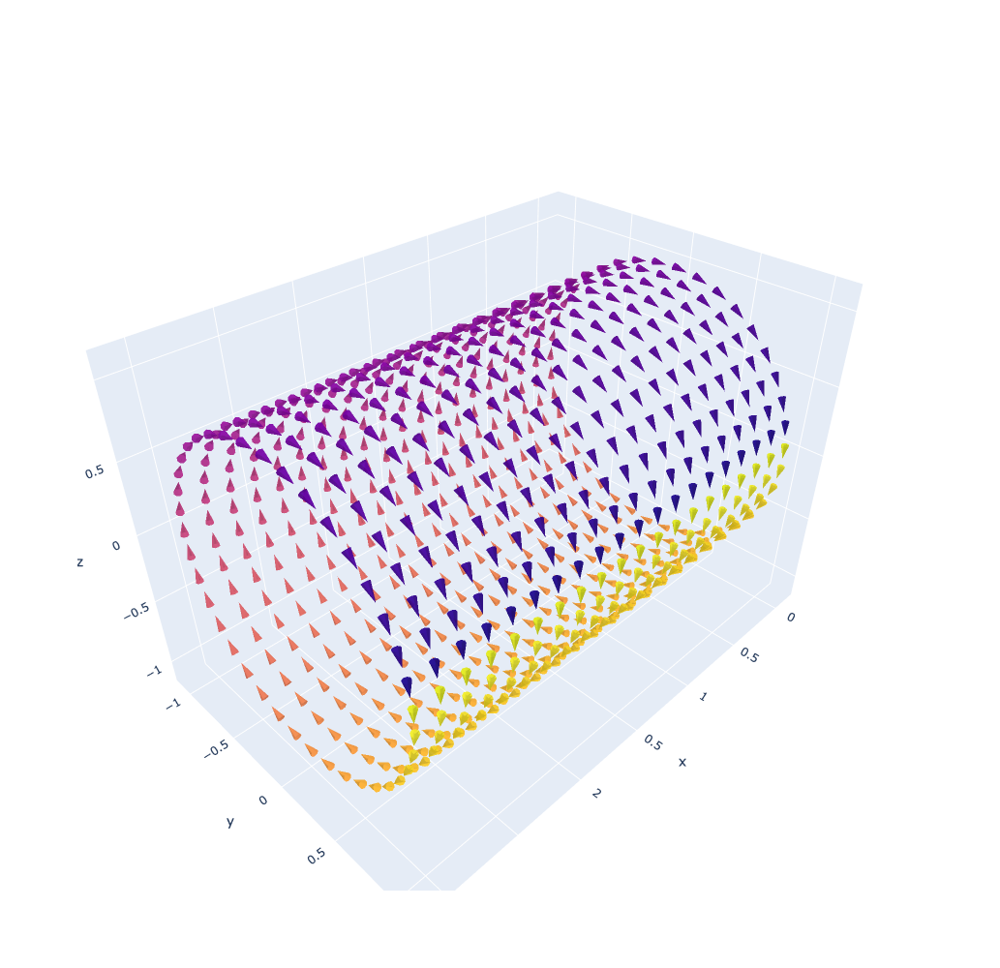

In [25]:
theta = np.linspace(0, 2 * np.pi, 40)

r=1
height = 3
resolution = 20
y_circle = r * np.cos(theta)
z_circle = r * np.sin(theta)
x = np.linspace(0, height, resolution)
#colormap = create_plotly_colordict('plasma', resolution)
colormap = create_plotly_colordict('plasma', theta.shape[0])
coords = np.empty([resolution*theta.shape[0], 9])

fig = go.Figure()
count = 0

for i in range(x.shape[0]):
    for j in range(theta.shape[0]):
        y_tan, z_tan = after_coord_1_unit(y_circle[j], z_circle[j], 1) 
        #create_quiver needs the start and end coordinates 
        final_x = y_circle[j] + y_tan
        final_y = z_circle[j] + z_tan
        coords[count,:] = np.array([x[i], y_circle[j], z_circle[j], 0, y_tan, z_tan, j, final_x, final_y])
        count +=1
        
        u=[0,None]
        v=[y_tan,None]
        w=[z_tan,None]
        xx=[x[i],None]
        # Cone needs the change in the vector 
        yy=[y_circle[j],None]
        zz=[z_circle[j],None]
    
        #cl=plotly.colors.DEFAULT_PLOTLY_COLORS[i]
        cl = colormap[j]
        fig = fig.add_cone(opacity=0.75, 
                           sizemode='absolute',
                           sizeref=0.1,
                           showscale=False,
                           colorscale=[cl,cl],
                           anchor='tip', #['tip', 'tail', 'cm', 'center']
            x=xx,
            y=yy,
            z=zz,
            u=u,
            v=v,
            w=w,
                          )
fig.update_layout(scene_aspectmode='data',height=1000)
fig.show()
#fig.write_html("../plots/3D_vf/3D_cylinder_vf.html")

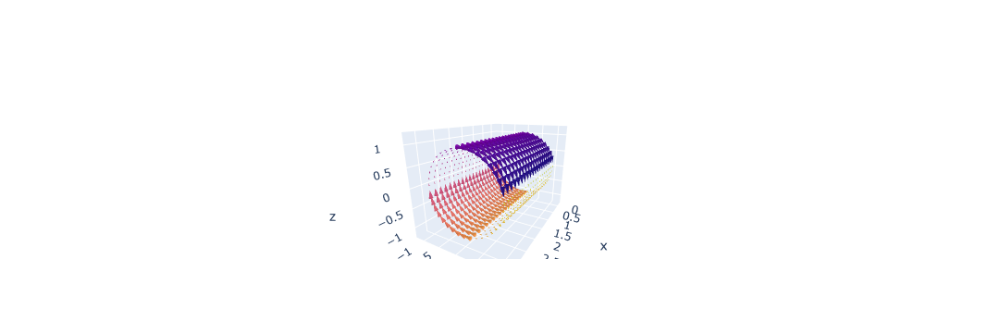

In [21]:
theta = np.linspace(0, 2 * np.pi, 40)

r=1
height = 3
resolution = 20
y_circle = r * np.cos(theta)
z_circle = r * np.sin(theta)
x = np.linspace(0, height, resolution)

colormap = create_plotly_colordict('plasma', theta.shape[0])
coords = np.empty([resolution*theta.shape[0], 9])

fig = go.Figure()
count = 0

for i in range(x.shape[0]):
    for j in range(theta.shape[0]):
        y_tan, z_tan = after_coord_var_unit(y_circle[j], z_circle[j], 1) 
        #create_quiver needs the start and end coordinates 
        final_x = y_circle[j] + y_tan
        final_y = z_circle[j] + z_tan
        coords[count,:] = np.array([x[i], y_circle[j], z_circle[j], 0, y_tan, z_tan, j, final_x, final_y])
        count +=1
        
        u=[0,None]
        v=[y_tan,None]
        w=[z_tan,None]
        xx=[x[i],None]
        # Cone needs the change in the vector 
        yy=[y_circle[j],None]
        zz=[z_circle[j],None]
    
        #cl=plotly.colors.DEFAULT_PLOTLY_COLORS[i]
        cl = colormap[j]
        fig = fig.add_cone(opacity=0.75, 
                           #sizemode='absolute',
                           sizeref=0.1,
                           showscale=False,
                           colorscale=[cl,cl],
                           anchor='tip', #['tip', 'tail', 'cm', 'center']
            x=xx,
            y=yy,
            z=zz,
            u=u,
            v=v,
            w=w,
                          )
fig.update_layout(scene_aspectmode='data',height=1000)
fig.show()
#fig.write_html("../plots/3D_vf/3D_cylinder_vf.html")

In [38]:
del coords

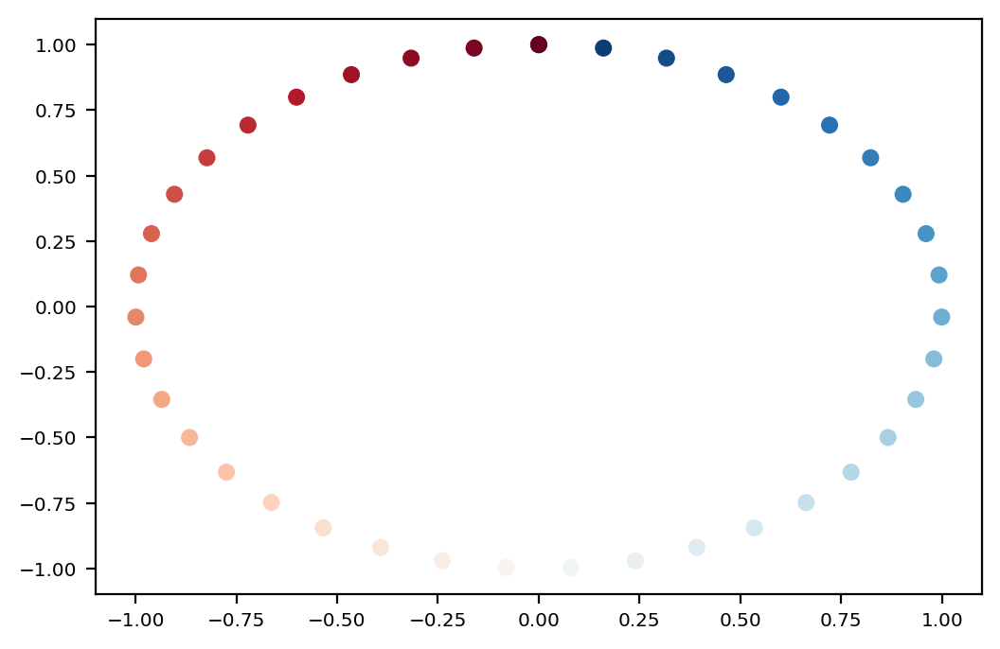

In [225]:
plt.scatter(np.sin(theta), np.cos(theta), c=range(theta.shape[0]))

In [13]:
theta = np.linspace(0, 2 * np.pi, 40)

r=1
height = 3
resolution = 20
y_circle = r * np.cos(theta)
z_circle = r * np.sin(theta)
x = np.linspace(0, height, resolution)

colormap = create_plotly_colordict('plasma', theta.shape[0])
coords = np.empty([resolution*theta.shape[0], 9])

fig = go.Figure()
count = 0

for i in range(x.shape[0]):
    for j in range(theta.shape[0]):
        y_tan, z_tan = after_coord_var_unit2(y_circle[j], z_circle[j], 1, theta[j]) 
        #create_quiver needs the start and end coordinates 
        final_x = y_circle[j] + y_tan
        final_y = z_circle[j] + z_tan
        coords[count,:] = np.array([x[i], y_circle[j], z_circle[j], 0, y_tan, z_tan, j, final_x, final_y])
        count +=1
        
        u=[0,None]
        v=[y_tan,None]
        w=[z_tan,None]
        xx=[x[i],None]
        # Cone needs the change in the vector 
        yy=[y_circle[j],None]
        zz=[z_circle[j],None]
    
        #cl=plotly.colors.DEFAULT_PLOTLY_COLORS[i]
        cl = colormap[j]
        fig = fig.add_cone(opacity=0.75, 
                           #sizemode='absolute',
                           sizeref=0.07,
                           showscale=False,
                           colorscale=[cl,cl],
                           anchor='tip', #['tip', 'tail', 'cm', 'center']
            x=xx,
            y=yy,
            z=zz,
            u=u,
            v=v,
            w=w,
                          )
fig.update_layout(scene_aspectmode='data',height=1000)
fig.show()
#fig.write_html("../plots/3D_vf_variation/3D_cylinder_vf.html")

# Projecting velocity vectors to 2D

In [14]:
def get_neighbor_indices(
    adjacency_list: np.ndarray,
    source_idx: int,
    n_order_neighbors: int = 2,
    max_neighbors_num: int = None,
) -> np.ndarray:
    """Get a list (np.array) of `n_order_neighbors` neighbor indices of source_idx.

    If `max_neighbors_num` is set and the n order neighbors of `source_idx` is larger than `max_neighbors_num`, a list
    of neighbors will be randomly chosen and returned.

    Args:
        adjacency_list: The adjacency list of the graph.
        source_idx: The index of the source node.
        n_order_neighbors: The number of neighbor orders to consider, which controls the depth of iterative neighbor
            search.
        max_neighbors_num: The maximum number of neighbors to return.

    Returns:
        A list of neighbor indices.
    """
    _indices = [source_idx]
    for _ in range(n_order_neighbors):
        _indices = np.append(_indices, adjacency_list[_indices])
        if np.isnan(_indices).any():
            _indices = _indices[~np.isnan(_indices)]
    _indices = np.unique(_indices)
    if max_neighbors_num is not None and len(_indices) > max_neighbors_num:
        _indices = np.random.choice(_indices, max_neighbors_num, replace=False)
    return _indices

In [15]:
def einsum_correlation(X: np.ndarray, Y_i: np.ndarray, type: str = "pearson") -> np.ndarray:
    """Calculate pearson or cosine correlation between gene expression data and the velocity vectors.

    Args:
        X: The gene expression data (genes x cells).
        Y_i: The velocity vector.
        type: The type of correlation to be calculated. Defaults to "pearson".

    Returns:
        The correlation matrix.
    """

    if type == "pearson":
        X -= X.mean(axis=1)[:, None]
        Y_i -= np.nanmean(Y_i)
    elif type == "cosine":
        X, Y_i = X, Y_i
    elif type == "spearman":
        # check this
        X = stats.rankdata(X, axis=1)
        Y_i = stats.rankdata(Y_i)
    elif type == "kendalltau":
        corr = np.array([stats.kendalltau(x, Y_i)[0] for x in X])
        return corr[None, :]

    X_norm, Y_norm = norm(X, axis=1), norm(Y_i)

    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        if Y_norm == 0:
            corr = np.zeros(X_norm.shape[0])
        else:
            corr = np.einsum("ij, j", X, Y_i) / (X_norm * Y_norm)[None, :]

    return corr

In [16]:
def split_velocity_graph(
    G,
    neg_cells_trick: bool = True,
):
    """Split velocity graph (built either with correlation or with cosine kernel
    into one positive graph and one negative graph"""

    if not sp.issparse(G):
        G = sp.csr_matrix(G)
    if neg_cells_trick:
        G_ = G.copy()
    G.data[G.data < 0] = 0
    G.eliminate_zeros()

    if neg_cells_trick:
        G_.data[G_.data > 0] = 0
        G_.eliminate_zeros()

        return (G, G_)
    else:
        return G

In [17]:
def projection_with_transition_matrix(
    T, X_embedding, correct_density = True, norm_dist= True
):
    """Project velocity vectors to a low-dimensional embedding using a transition matrix.

    Args:
        T: The transition matrix representing velocity vectors. It can be a dense numpy array or a sparse csr_matrix.
        X_embedding: The low-dimensional embedding coordinates as a 2D numpy array. Each row represents the
            embedding coordinates of a cell in `T`.
        correct_density: Whether to correct the density of the projected velocity vectors.
        norm_dist: Whether to normalize the difference in embedding coordinates between connected cells before
            projecting the velocity vectors.

    Returns:
        A numpy array containing the projected velocity vectors for each cell in the embedding.
    """
    n = T.shape[0]
    delta_X = np.zeros((n, X_embedding.shape[1]))

    if not sp.issparse(T):
        T = sp.csr_matrix(T)

    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        for i in (range(n)):
            idx = T[i].indices
            diff_emb = X_embedding[idx] - X_embedding[i, None]
            if norm_dist:
                diff_emb /= norm(diff_emb, axis=1)[:, None]
            if np.isnan(diff_emb).sum() != 0:
                diff_emb[np.isnan(diff_emb)] = 0
            T_i = T[i].data
            delta_X[i] = T_i.dot(diff_emb)
            if correct_density:
                delta_X[i] -= T_i.mean() * diff_emb.sum(0)

    return delta_X

In [18]:
def norm(x, **kwargs):
    """Calculate the norm of an array or matrix

    Args:
        x: The array.
        kwargs: Other kwargs passed to `sp.linalg.norm` or `np.linalg.norm`.
    """
    if sp.issparse(x):
        return sp.linalg.norm(x, **kwargs)
    else:
        return np.linalg.norm(x, **kwargs)

In [19]:
def project_to_2D(X, X_embedding, V, neighbors, kernel, neg_cells_trick=True, use_neg_vals=True):
    n = X.shape[0]
    delta_X = np.zeros((n, X_embedding.shape[1]))

    rows = []
    cols = []
    vals = []
    
    for cur_i in range(n):
        velocity = V[cur_i, :]
        #print("velocity: ", velocity)
        if velocity.sum() != 0:   
            #print("here")
            neighbor_index_vals = neighbors[cur_i,:].astype(int)
            diff = X[neighbor_index_vals, :] - X[cur_i, :]

            diff_velocity = np.sign(velocity) * np.sqrt(np.abs(velocity))
            diff_rho = np.sign(diff) * np.sqrt(np.abs(diff))

            if kernel == "pearson":
                vals_ = einsum_correlation(diff_rho, diff_velocity, type="pearson")
            elif kernel == "cosine":
                vals_ = einsum_correlation(diff_rho, diff_velocity, type="cosine")
            
            rows.extend([cur_i] * len(neighbor_index_vals))
            cols.extend(neighbor_index_vals)
            vals.extend(vals_)
    #print(vals)
    vals = np.hstack(vals)
    vals[np.isnan(vals)] = 0
    G = sp.csr_matrix((vals, (rows, cols)), shape=(X_embedding.shape[0], X_embedding.shape[0]))
    G = split_velocity_graph(G, neg_cells_trick)
    #print(G)
    if neg_cells_trick:
        G, G_ = G
    
    confidence, ub_confidence = G.max(1).A.flatten(), np.percentile(G.max(1).A.flatten(), 98)
    dig_p = np.clip(ub_confidence - confidence, 0, 1)
    G.setdiag(dig_p)

    T = np.expm1(G / 0.1)

    if neg_cells_trick:
        if use_neg_vals:
            T -= np.expm1(-G_ / 0.1)
        else:
            T += np.expm1(G_ / 0.1)
            T.data = T.data + 1
    sparsefuncs.inplace_row_scale(T, 1 / np.abs(T).sum(axis=1).A1)

    T.setdiag(0)
    T.eliminate_zeros()

    delta_X = projection_with_transition_matrix(T, X_embedding, correct_density=True)
    return delta_X

In [20]:
neighbors = np.empty([coords.shape[0], 31])
for i in range(coords.shape[0]):
    neighbors[i,: ] = getNNeighbors(coords[i,:3], coords[:,:3], k=31)
neighbors = neighbors[:,1:]

In [21]:
X = coords[:,:3]
V = coords[:,[3,4,5]]

In [22]:
V

array([[ 0.        ,  0.        , -0.6       ],
       [ 0.        ,  0.10104619, -0.62522327],
       [ 0.        ,  0.38353653, -1.13862408],
       ...,
       [ 0.        , -0.38353653, -1.13862408],
       [ 0.        , -0.10104619, -0.62522327],
       [ 0.        ,  0.        , -0.6       ]])

In [210]:
# X = coords[:,:3]
# V = coords[:,[3,7,8]]

In [23]:
cm = plt.get_cmap("plasma", 40)

In [24]:
X_df = pd.DataFrame(X, columns=['X','Y','Z'])

In [25]:
temp = []
num = 0
for i in range(X_df.shape[0]):
    if i%40 == 0:
        num = 0
    temp.append('rgb('+ str(int(cm(num)[0]*255))+','+str(int(cm(num)[1]*255)) + ',' + str(int(cm(num)[2]*255)) + ')')
    num +=1
#X_df = pd.DataFrame(X_pca, columns=['PCA1', 'PCA2'])
X_df['color'] = temp

# UMAP

In [53]:
umap_model = umap.UMAP(n_components=2, random_state=42, n_neighbors=10, min_dist=0.1, metric='euclidean')
X_embedding = umap_model.fit_transform(X)

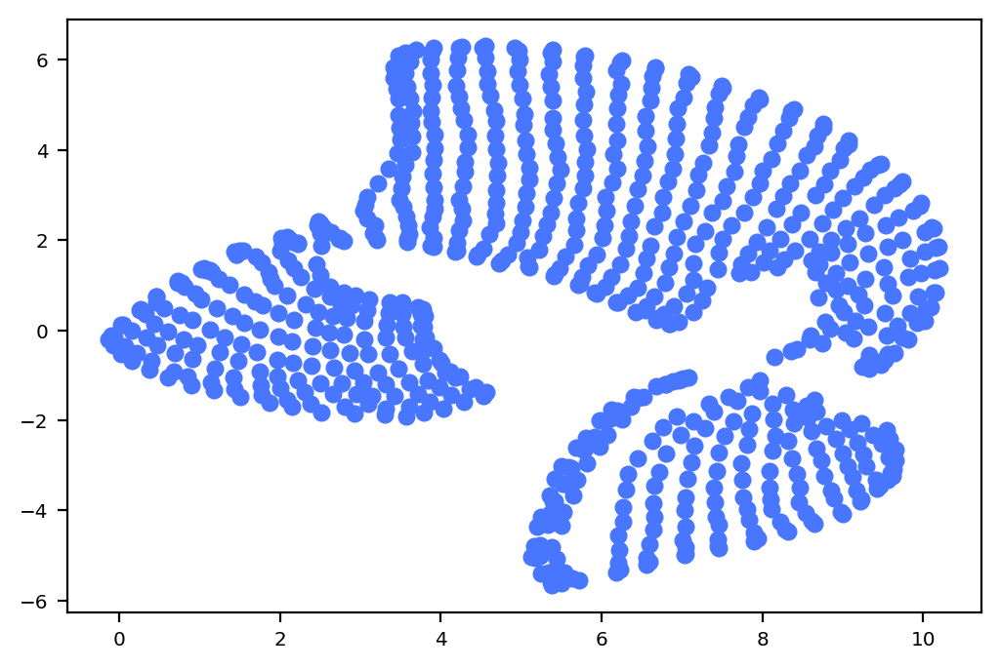

In [54]:
plt.scatter(X_embedding[:,0],
            X_embedding[:,1])

In [ ]:
#np.save("../generated_data/2d_coordinates/2d_umap.npy", X_embedding)

In [55]:
deltaX = project_to_2D(X, X_embedding, V, neighbors, kernel = 'cosine', neg_cells_trick=True)

In [56]:
deltaX_df = pd.DataFrame(deltaX)
deltaX_df = deltaX_df.fillna(0)

In [57]:
deltaX2 = project_to_2D(X, X_embedding, V, neighbors, kernel = 'pearson', neg_cells_trick=True)

In [58]:
deltaX2_df = pd.DataFrame(deltaX2)
deltaX2_df = deltaX2_df.fillna(0)

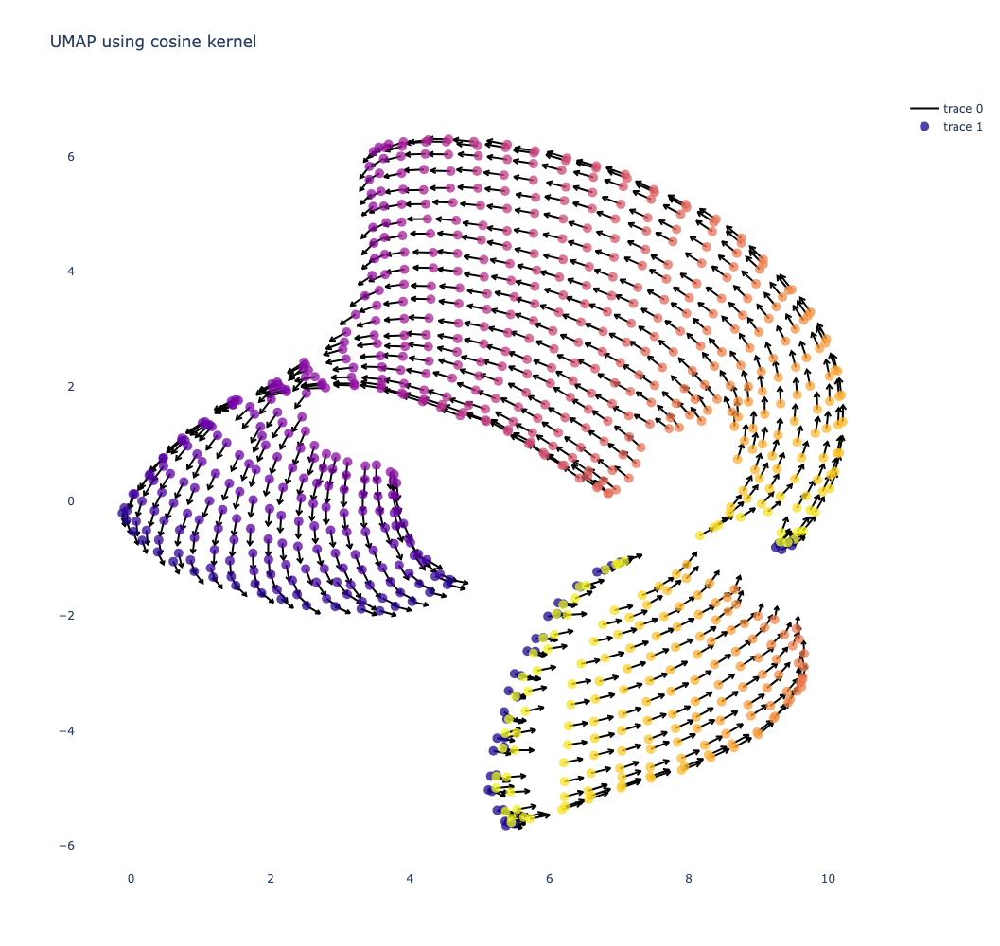

In [76]:
fig = ff.create_quiver(X_embedding[:,0], 
                       X_embedding[:,1], 
                       deltaX_df[0], 
                       deltaX_df[1], 
                       scale=0.3, 
                       #scaleratio=1, 
                       angle=np.pi/6,
                       marker_color='black')
fig.add_trace(go.Scatter(x=X_embedding[:, 0], 
                         y=X_embedding[:, 1],
                         mode='markers',
                         marker_size=10,
                         marker_color=coords[:, 6],
                        ))
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data',height=1000, width=950, title = "UMAP using cosine kernel",
                  plot_bgcolor='white',)
fig.show()
fig.write_html("../plots/3D_vf_variation/cosine_kernel/2D_cylinder_UMAP.html")

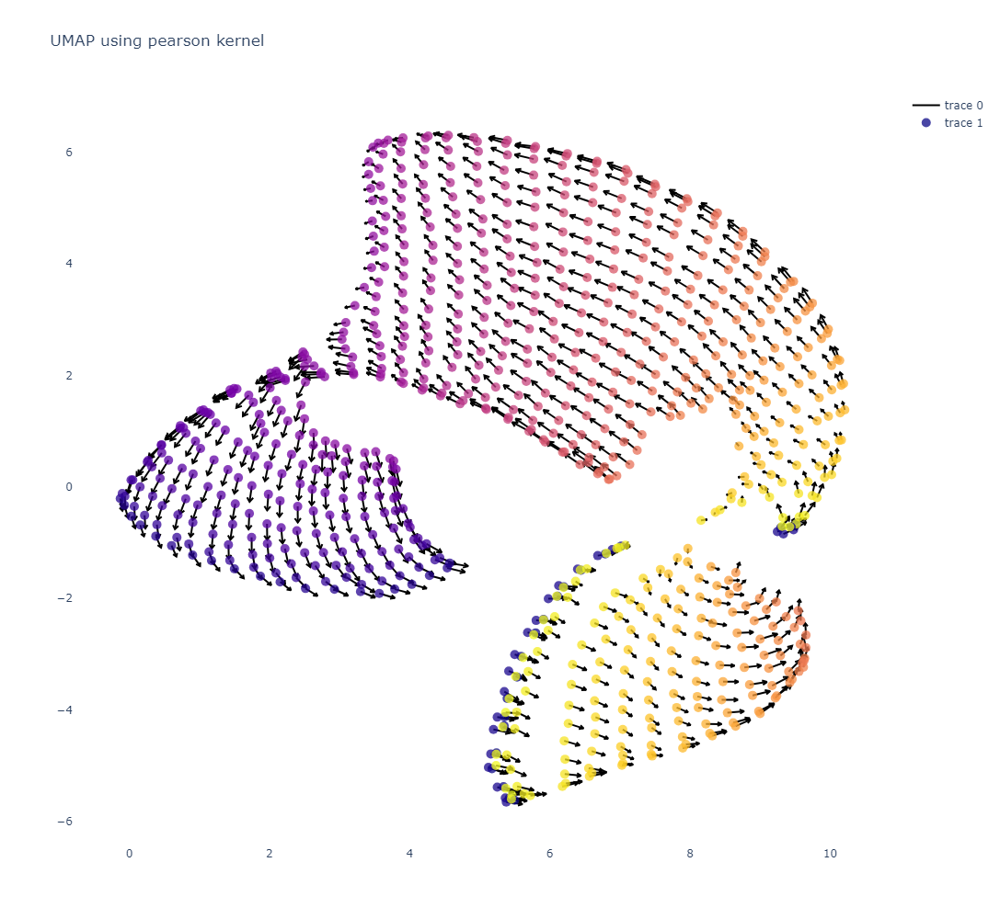

In [75]:
fig = ff.create_quiver(X_embedding[:,0], 
                       X_embedding[:,1], 
                       deltaX2_df[0], 
                       deltaX2_df[1], 
                       scale=0.3, 
                       #scaleratio=1, 
                       angle=np.pi/6,
                       marker_color='black')
fig.add_trace(go.Scatter(x=X_embedding[:, 0], 
                         y=X_embedding[:, 1],
                         mode='markers',
                         marker_size=10,
                         marker_color=coords[:, 6],
                        ))
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data',height=1000, width=950, title = "UMAP using pearson kernel",
                  #template='plotly_dark',
                  plot_bgcolor='white',
                  #paper_bgcolor='rgba(0, 0, 0, 0)'
                 )
fig.show()
fig.write_html("../plots/3D_vf_variation/pearson_kernel/2D_cylinder_UMAP.html")

# PCA

In [26]:
pca_model = pca = PCA(n_components=2)
X_pca = pca_model.fit_transform(X)

In [80]:
np.save("../generated_data/2d_coordinates/2d_pca.npy", X_pca)

In [27]:
deltaX = project_to_2D(X, X_pca, V, neighbors, kernel = 'cosine', neg_cells_trick=True)

In [28]:
deltaX_df = pd.DataFrame(deltaX)
deltaX_df = deltaX_df.fillna(0)

In [29]:
deltaX2 = project_to_2D(X, X_pca, V, neighbors, kernel = 'pearson', neg_cells_trick=True)

In [30]:
deltaX2_df = pd.DataFrame(deltaX2)
deltaX2_df = deltaX2_df.fillna(0)

In [31]:
deltaX_df.shape

(800, 2)

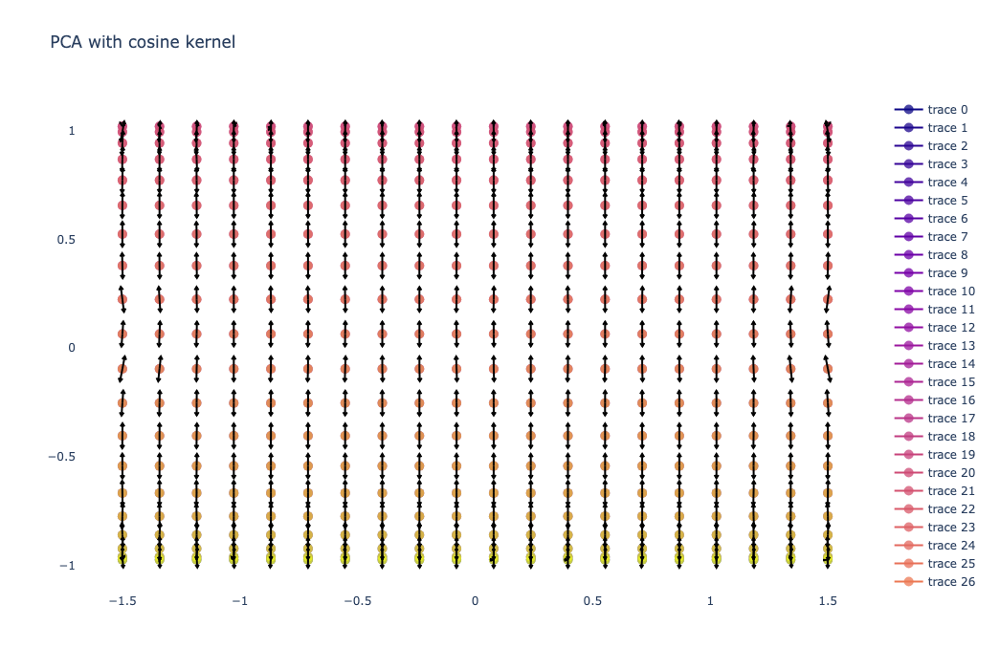

In [333]:
fig = go.Figure()
temp = X_df.reset_index(drop='True')
for i in range(temp.shape[0]):
    cl = temp.iloc[i]['color']
    fig.add_trace(
        go.Scatter(
            x=[temp.iloc[i]['PCA1']],
            y=[temp.iloc[i]['PCA2']],
            marker_color=temp.iloc[i]['color'],
            marker_size=10
            )
    )
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data', width=1000, height=700,
                  title="PCA with cosine kernel",
                  plot_bgcolor='white'
                 )
fig2 = ff.create_quiver(temp['PCA1'], 
                        temp['PCA2'], 
                        deltaX_df.iloc[:][0], 
                        deltaX_df.iloc[:][1], 
                        scale=0.06,
                        angle=np.pi/6,
                        marker_color='black')
fig.add_traces(data = fig2.data)
fig.show()
fig.write_html("../plots/3D_vf_variation/cosine_kernel/2D_cylinder_PCA_both.html")

In [245]:
cm = plt.get_cmap("plasma", 40)

In [33]:
X_df['PCA1'] = X_pca[:,0]
X_df['PCA2'] = X_pca[:,1]

In [269]:
indexes = []
for i in range(0,20,1):
    temp = np.arange(i, X_pca.shape[0], 40)
    for j in range(len(temp)):
        indexes.append(temp[j])

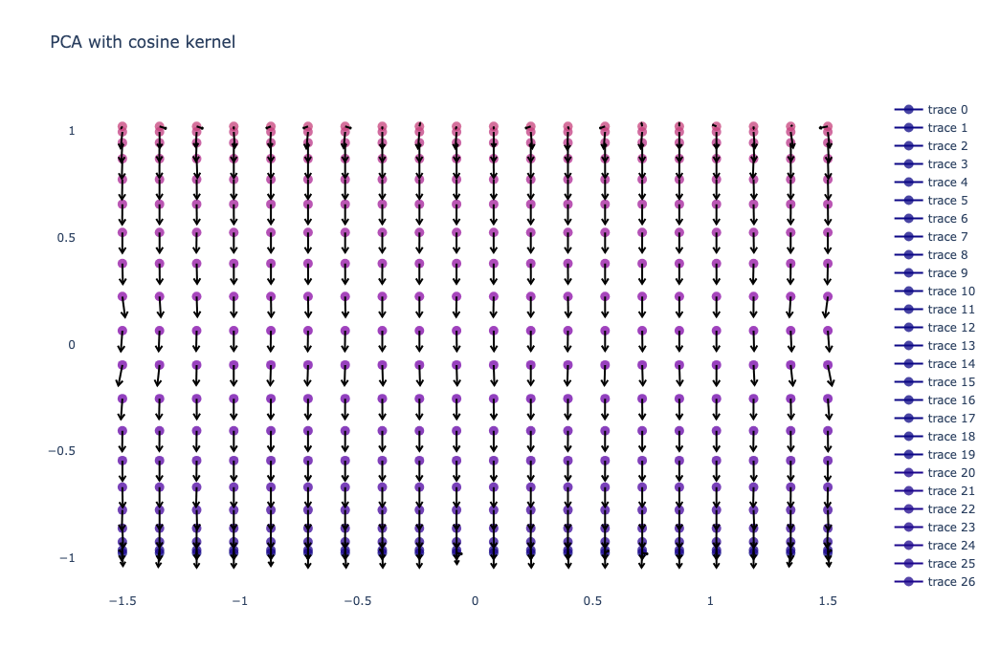

In [270]:
fig = go.Figure()
temp = X_df.iloc[indexes].reset_index(drop='True')
for i in range(temp.shape[0]):
    cl = temp.iloc[i]['color']
    fig.add_trace(
        go.Scatter(
            x=[temp.iloc[i]['PCA1']],
            y=[temp.iloc[i]['PCA2']],
            marker_color=temp.iloc[i]['color'],
            marker_size=10
            )
    )
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data', width=1000, height=700,
                  title="PCA with cosine kernel",
                  plot_bgcolor='white'
                 )
fig2 = ff.create_quiver(temp['PCA1'], 
                        temp['PCA2'], 
                        deltaX_df.iloc[indexes][0], 
                        deltaX_df.iloc[indexes][1], 
                        scale=0.1,
                        angle=np.pi/6,
                        #scaleratio=0.7, 
                        marker_color='black')
fig.add_traces(data = fig2.data)
fig.show()
fig.write_html("../plots/3D_vf_variation/cosine_kernel/2D_cylinder_PCA_s1.html")

In [271]:
indexes = []
for i in range(20,40,1):
    temp = np.arange(i, X_pca.shape[0], 40)
    for j in range(len(temp)):
        indexes.append(temp[j])

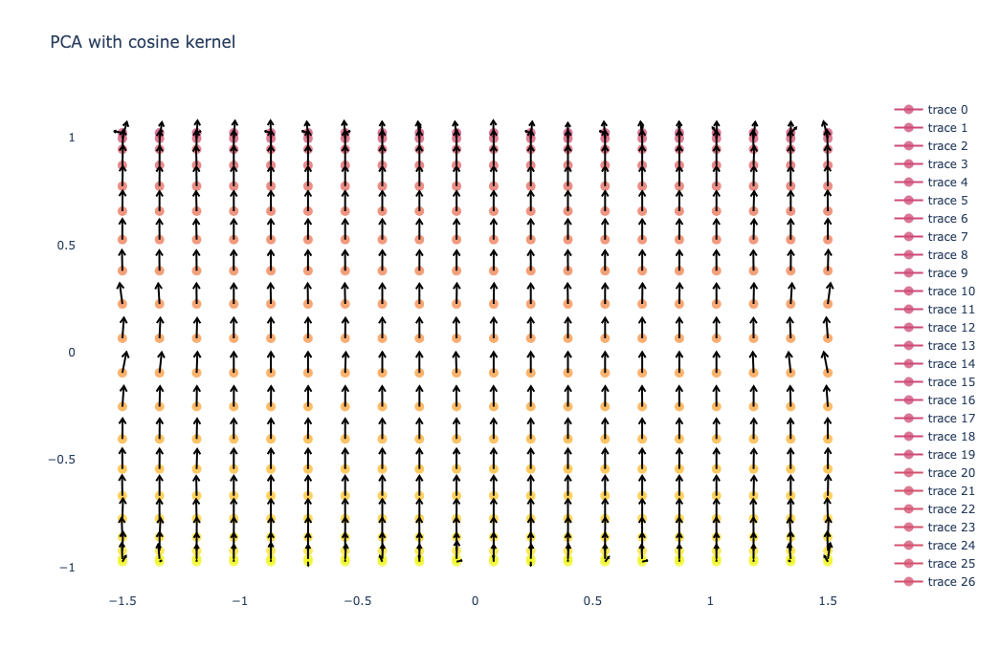

In [272]:
fig = go.Figure()
temp = X_df.iloc[indexes].reset_index(drop='True')
for i in range(temp.shape[0]):
    cl = temp.iloc[i]['color']
    fig.add_trace(
        go.Scatter(
            x=[temp.iloc[i]['PCA1']],
            y=[temp.iloc[i]['PCA2']],
            marker_color=temp.iloc[i]['color'],
            marker_size=10
            )
    )
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data', width=1000, height=700,
                  title="PCA with cosine kernel",
                  plot_bgcolor='white'
                 )
fig2 = ff.create_quiver(temp['PCA1'], 
                        temp['PCA2'], 
                        deltaX_df.iloc[indexes][0], 
                        deltaX_df.iloc[indexes][1], 
                        scale=0.1,
                        angle=np.pi/6,
                        #scaleratio=0.7, 
                        marker_color='black')
fig.add_traces(data = fig2.data)
fig.show()
fig.write_html("../plots/3D_vf_variation/cosine_kernel/2D_cylinder_PCA_s2.html")

In [60]:
indexes = []
for i in range(0,20,1):
    temp = np.arange(i, X_pca.shape[0], 40)
    for j in range(len(temp)):
        indexes.append(temp[j])

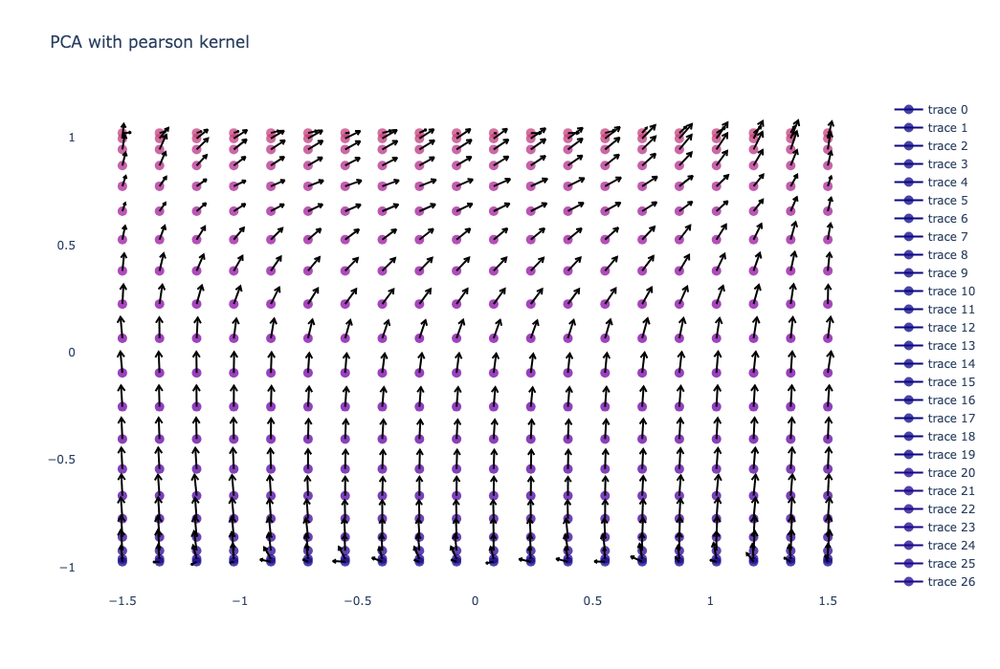

In [61]:
fig = go.Figure()
temp = X_df.iloc[indexes].reset_index(drop='True')
for i in range(temp.shape[0]):
    cl = temp.iloc[i]['color']
    fig.add_trace(
        go.Scatter(
            x=[temp.iloc[i]['PCA1']],
            y=[temp.iloc[i]['PCA2']],
            marker_color=temp.iloc[i]['color'],
            marker_size=10
            )
    )
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data', width=1000, height=700,
                  #yaxis_range=[-.05,0.05],
                  #xaxis_range=[-.05,0.05],
                  title="PCA with pearson kernel",
                  plot_bgcolor='white'
                 )
fig2 = ff.create_quiver(temp['PCA1'], 
                        temp['PCA2'], 
                        deltaX2_df.iloc[indexes][0], 
                        deltaX2_df.iloc[indexes][1], 
                        scale=0.1,
                        angle=np.pi/6,
                        #scaleratio=0.7, 
                        marker_color='black')
fig.add_traces(data = fig2.data)
fig.show()
fig.write_html("../plots/3D_vf_variation/pearson_kernel/2D_cylinder_PCA_s1.html")

In [62]:
indexes = []
for i in range(20,40,1):
    temp = np.arange(i, X_pca.shape[0], 40)
    for j in range(len(temp)):
        indexes.append(temp[j])

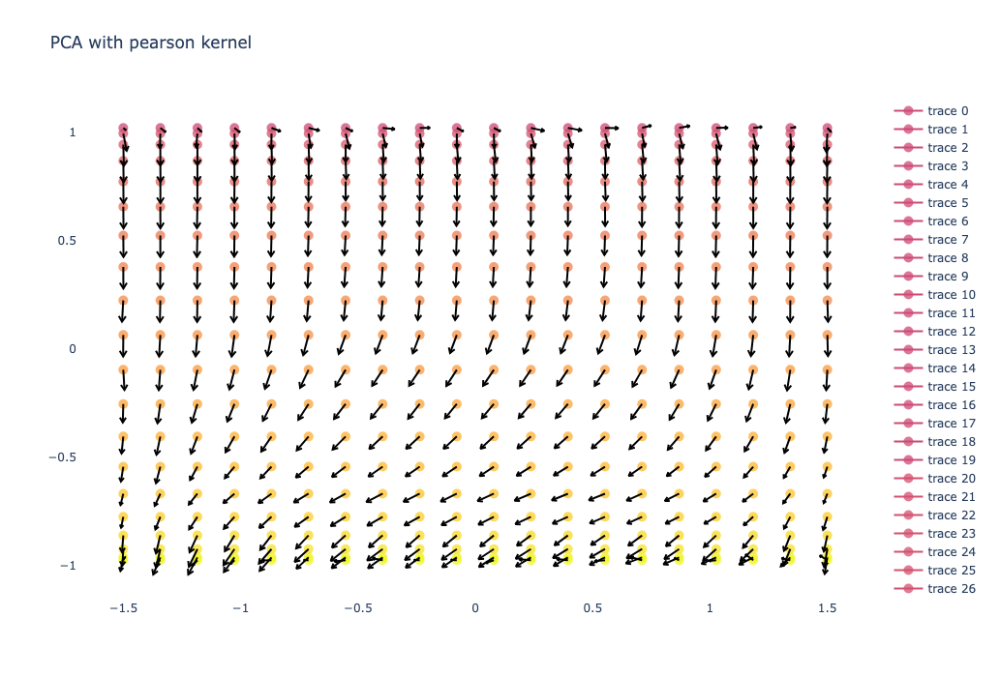

In [63]:
fig = go.Figure()
temp = X_df.iloc[indexes].reset_index(drop='True')
for i in range(temp.shape[0]):
    cl = temp.iloc[i]['color']
    fig.add_trace(
        go.Scatter(
            x=[temp.iloc[i]['PCA1']],
            y=[temp.iloc[i]['PCA2']],
            marker_color=temp.iloc[i]['color'],
            marker_size=10
            )
    )
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data', width=1000, height=700,
                  title="PCA with pearson kernel",
                  plot_bgcolor='white'
                 )
fig2 = ff.create_quiver(temp['PCA1'], 
                        temp['PCA2'], 
                        deltaX2_df.iloc[indexes][0], 
                        deltaX2_df.iloc[indexes][1], 
                        scale=0.1,
                        angle=np.pi/6,
                        #scaleratio=0.7, 
                        marker_color='black')
fig.add_traces(data = fig2.data)
fig.show()
fig.write_html("../plots/3D_vf_variation/pearson_kernel/2D_cylinder_PCA_s2.html")

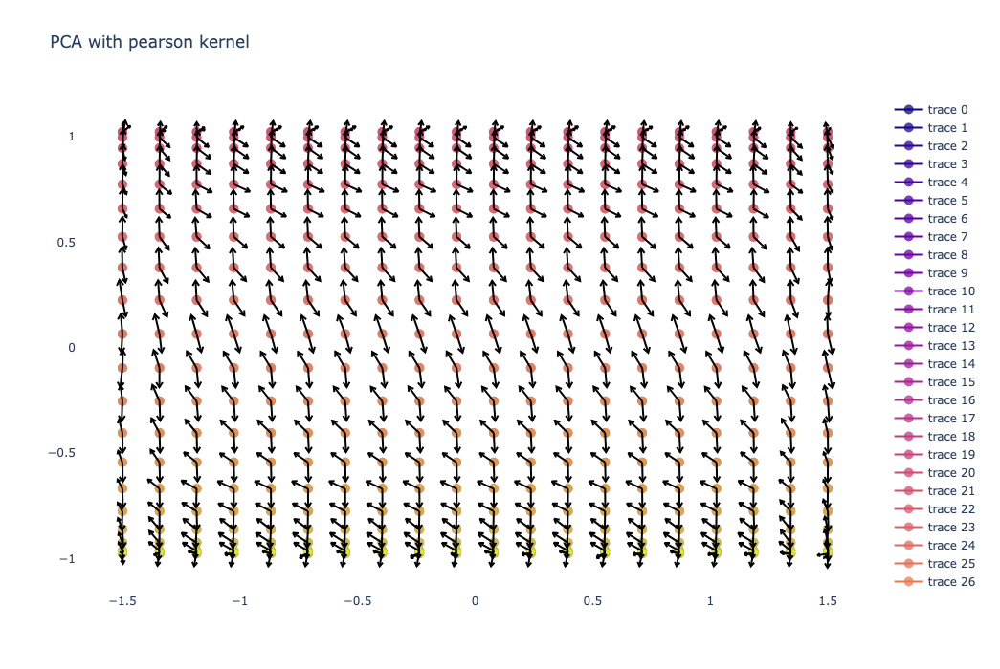

In [34]:
fig = go.Figure()
temp = X_df.reset_index(drop='True')
for i in range(temp.shape[0]):
    cl = temp.iloc[i]['color']
    fig.add_trace(
        go.Scatter(
            x=[temp.iloc[i]['PCA1']],
            y=[temp.iloc[i]['PCA2']],
            marker_color=temp.iloc[i]['color'],
            marker_size=10
            )
    )
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data', width=1000, height=700,
                  #yaxis_range=[-.05,0.05],
                  #xaxis_range=[-.05,0.05],
                  title="PCA with pearson kernel",
                  plot_bgcolor='white'
                 )
fig2 = ff.create_quiver(temp['PCA1'], 
                        temp['PCA2'], 
                        deltaX2_df.iloc[:][0], 
                        deltaX2_df.iloc[:][1], 
                        scale=0.1,
                        angle=np.pi/6,
                        #scaleratio=0.7, 
                        marker_color='black')
fig.add_traces(data = fig2.data)
fig.show()
fig.write_html("../plots/3D_vf_variation/pearson_kernel/2D_cylinder_PCA_both.html")

# PHATE

In [35]:
phate_operator = phate.PHATE()
Y_phate = phate_operator.fit_transform(X)

Calculating PHATE...
  Running PHATE on 800 observations and 3 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculating affinities...
  Calculated graph and diffusion operator in 0.31 seconds.
  Calculating optimal t...
    Automatically selected t = 25
  Calculated optimal t in 0.43 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.21 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 0.61 seconds.
Calculated PHATE in 1.57 seconds.


In [81]:
np.save("../generated_data/2d_coordinates/2d_phate.npy", Y_phate)

In [36]:
deltaX = project_to_2D(X, Y_phate, V, neighbors, kernel = 'cosine', neg_cells_trick=True)

In [37]:
deltaX_df = pd.DataFrame(deltaX)
deltaX_df = deltaX_df.fillna(0)

In [38]:
deltaX2 = project_to_2D(X, Y_phate, V, neighbors, kernel = 'pearson', neg_cells_trick=True)

In [39]:
deltaX2_df = pd.DataFrame(deltaX2)
deltaX2_df = deltaX2_df.fillna(0)

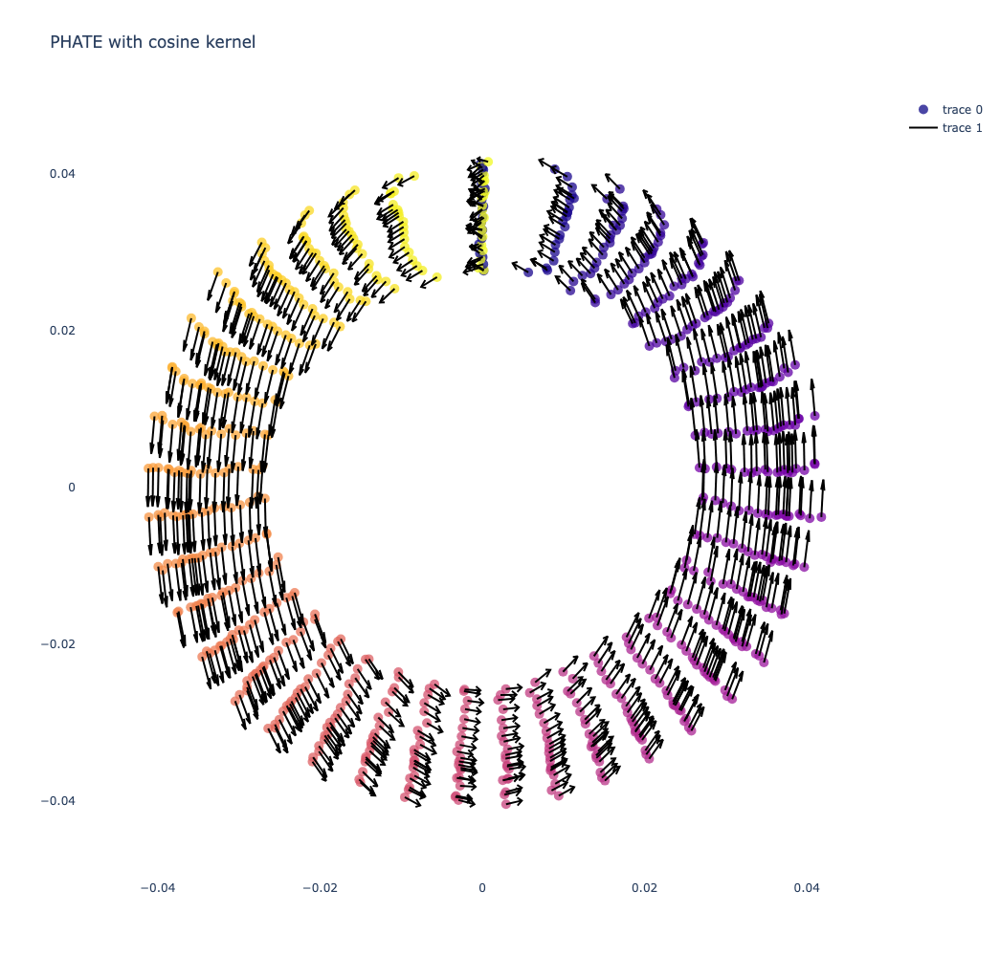

In [40]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=Y_phate[:, 0], 
                         y=Y_phate[:, 1],
                         mode='markers',
                         marker_size=10,
                         marker_color=coords[:, 6],
                        ))
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data', width=1000, height=1000,
                  yaxis_range=[-.05,0.05],
                  xaxis_range=[-.05,0.05],
                  title="PHATE with cosine kernel",
                  plot_bgcolor='white'
                 )
fig2 = ff.create_quiver(Y_phate[:,0], 
                        Y_phate[:,1], 
                        deltaX_df[0], 
                        deltaX_df[1], scale=0.005, scaleratio=0.4, marker_color='black')
fig.add_traces(data = fig2.data)
fig.show()
fig.write_html("../plots/3D_vf_variation/cosine_kernel/2D_cylinder_PHATE.html")

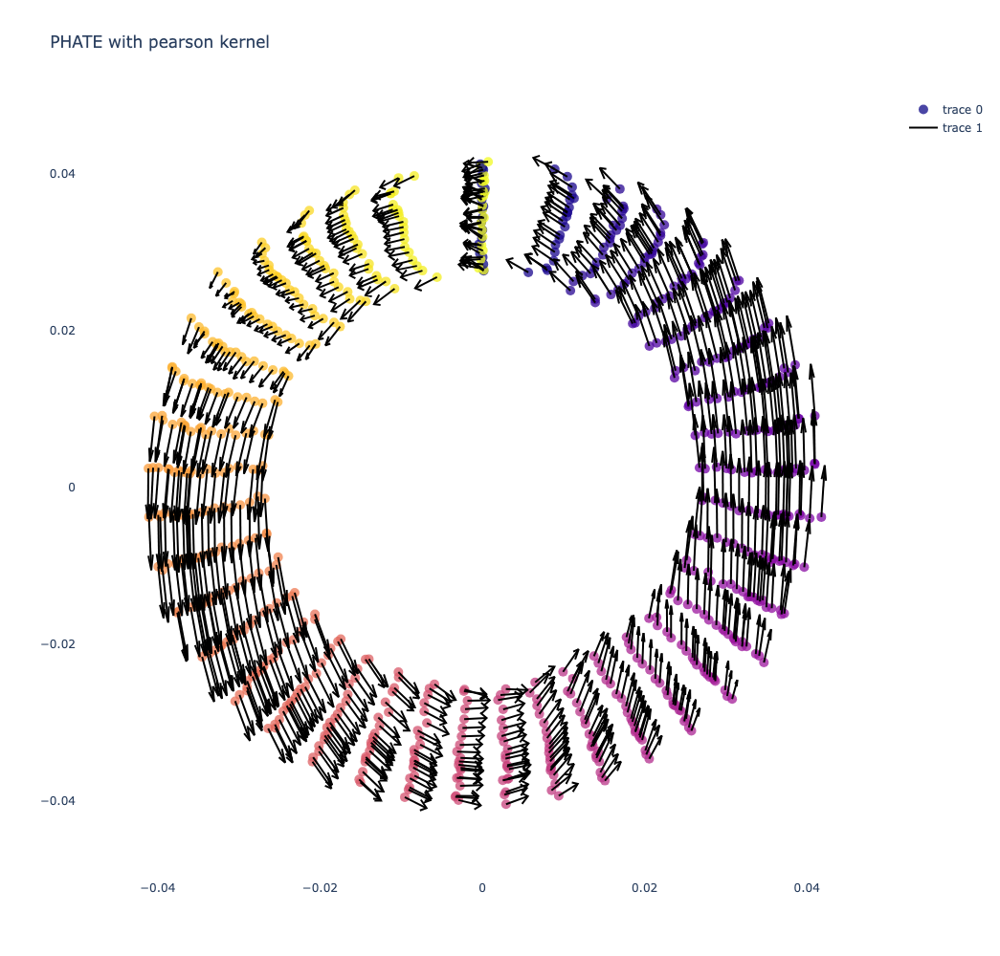

In [41]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=Y_phate[:, 0], 
                         y=Y_phate[:, 1],
                         mode='markers',
                         marker_size=10,
                         marker_color=coords[:, 6],
                        ))
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data', width=1000, height=1000,
                  yaxis_range=[-.05,0.05],
                  xaxis_range=[-.05,0.05],
                  title="PHATE with pearson kernel",
                  plot_bgcolor='white'
                 )
fig2 = ff.create_quiver(Y_phate[:,0], 
                        Y_phate[:,1], 
                        deltaX2_df[0], 
                        deltaX2_df[1], scale=0.007, scaleratio=0.4, marker_color='black')
fig.add_traces(data = fig2.data)
fig.show()
fig.write_html("../plots/3D_vf_variation/pearson_kernel/2D_cylinder_PHATE.html")

# Diffusion map

In [42]:
mydmap = dm.DiffusionMap.from_sklearn(n_evecs = 2, epsilon = 1.0, alpha = 1, k=64)

In [43]:
dmap_embedding = mydmap.fit_transform(X)

In [44]:
dmap_embedding.shape

(800, 2)

In [82]:
np.save("../generated_data/2d_coordinates/2d_diffusionMap.npy", dmap_embedding)

In [45]:
deltaX = project_to_2D(X, dmap_embedding, V, neighbors, kernel = 'cosine', neg_cells_trick=True)

In [46]:
deltaX_df = pd.DataFrame(deltaX)
deltaX_df = deltaX_df.fillna(0)

In [47]:
deltaX2 = project_to_2D(X, dmap_embedding, V, neighbors, kernel = 'pearson', neg_cells_trick=True)

In [48]:
deltaX2_df = pd.DataFrame(deltaX2)
deltaX2_df = deltaX2_df.fillna(0)

In [49]:
X_df['diffMap1'] = dmap_embedding[:,0] 
X_df['diffMap2'] = dmap_embedding[:,1]

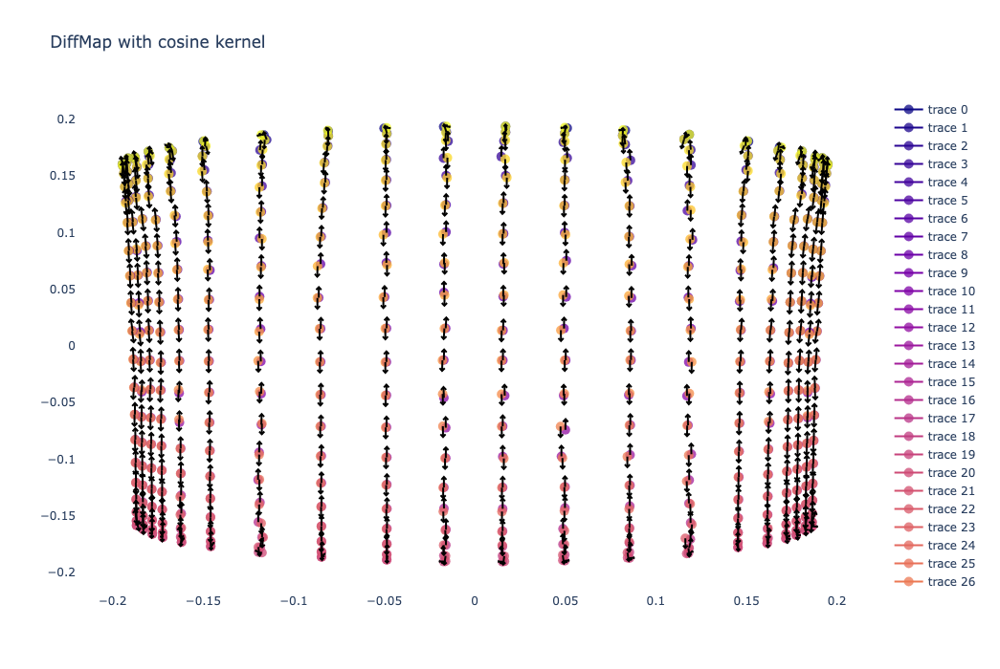

In [53]:
fig = go.Figure()
temp = X_df.reset_index(drop='True')
for i in range(temp.shape[0]):
    cl = temp.iloc[i]['color']
    fig.add_trace(
        go.Scatter(
            x=[temp.iloc[i]['diffMap1']],
            y=[temp.iloc[i]['diffMap2']],
            marker_color=temp.iloc[i]['color'],
            marker_size=10
            )
    )
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data', width=1000, height=700,
                  title="DiffMap with cosine kernel",
                  plot_bgcolor='white'
                 )
fig2 = ff.create_quiver(temp['diffMap1'], 
                        temp['diffMap2'], 
                        deltaX_df.iloc[:][0], 
                        deltaX_df.iloc[:][1], 
                        scale=0.01,
                        angle=np.pi/6,
                        #scaleratio=0.7, 
                        marker_color='black')
fig.add_traces(data = fig2.data)
fig.show()
fig.write_html("../plots/3D_vf_variation/cosine_kernel/2D_cylinder_diffMap_both.html")

In [302]:
indexes = []
for i in range(0,20,1):
    temp = np.arange(i, X_pca.shape[0], 40)
    for j in range(len(temp)):
        indexes.append(temp[j])

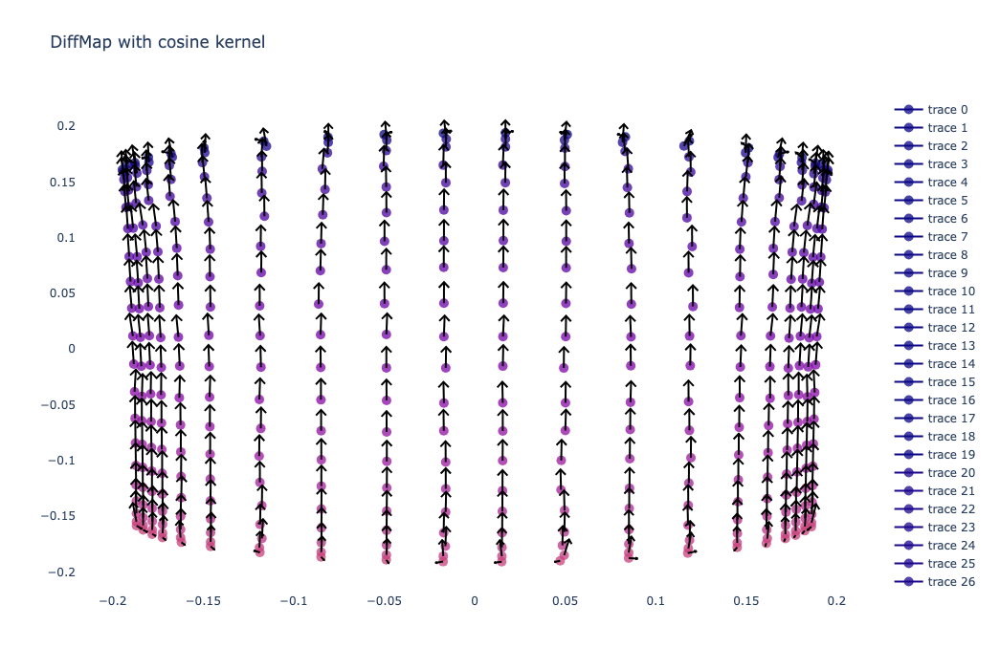

In [303]:
fig = go.Figure()
temp = X_df.iloc[indexes].reset_index(drop='True')
for i in range(temp.shape[0]):
    cl = temp.iloc[i]['color']
    fig.add_trace(
        go.Scatter(
            x=[temp.iloc[i]['diffMap1']],
            y=[temp.iloc[i]['diffMap2']],
            marker_color=temp.iloc[i]['color'],
            marker_size=10
            )
    )
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data', width=1000, height=700,
                  title="DiffMap with cosine kernel",
                  plot_bgcolor='white'
                 )
fig2 = ff.create_quiver(temp['diffMap1'], 
                        temp['diffMap2'], 
                        deltaX_df.iloc[indexes][0], 
                        deltaX_df.iloc[indexes][1], 
                        scale=0.02,
                        angle=np.pi/6,
                        #scaleratio=0.7, 
                        marker_color='black')
fig.add_traces(data = fig2.data)
fig.show()
fig.write_html("../plots/3D_vf_variation/cosine_kernel/2D_cylinder_diffMap_s1.html")

In [304]:
indexes = []
for i in range(20,40,1):
    temp = np.arange(i, X_pca.shape[0], 40)
    for j in range(len(temp)):
        indexes.append(temp[j])

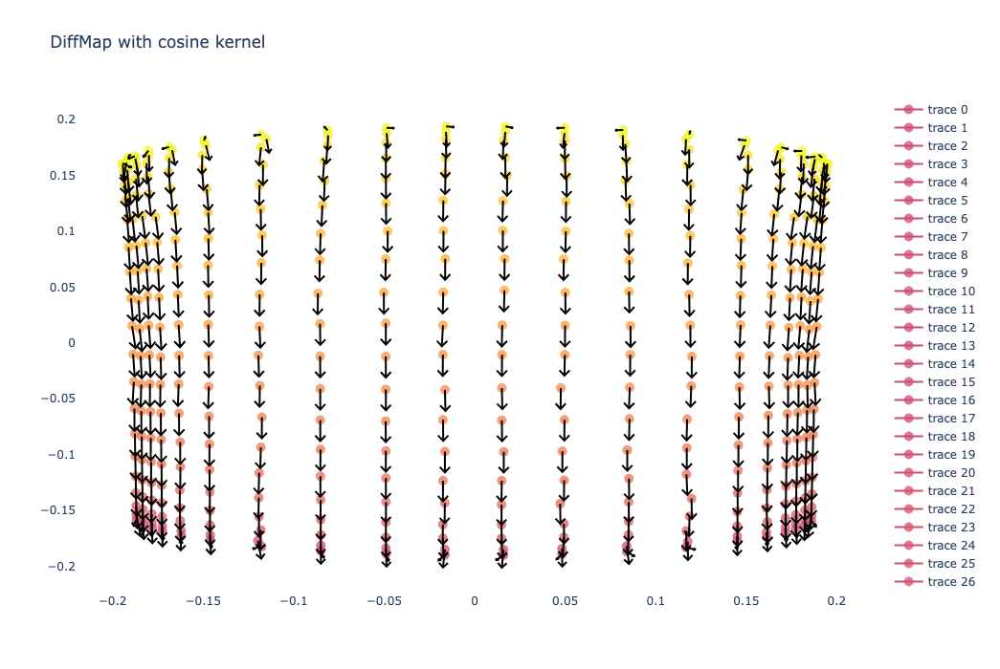

In [305]:
fig = go.Figure()
temp = X_df.iloc[indexes].reset_index(drop='True')
for i in range(temp.shape[0]):
    cl = temp.iloc[i]['color']
    fig.add_trace(
        go.Scatter(
            x=[temp.iloc[i]['diffMap1']],
            y=[temp.iloc[i]['diffMap2']],
            marker_color=temp.iloc[i]['color'],
            marker_size=10
            )
    )
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data', width=1000, height=700,
                  title="DiffMap with cosine kernel",
                  plot_bgcolor='white'
                 )
fig2 = ff.create_quiver(temp['diffMap1'], 
                        temp['diffMap2'], 
                        deltaX_df.iloc[indexes][0], 
                        deltaX_df.iloc[indexes][1], 
                        scale=0.02,
                        angle=np.pi/6,
                        #scaleratio=0.7, 
                        marker_color='black')
fig.add_traces(data = fig2.data)
fig.show()
fig.write_html("../plots/3D_vf_variation/cosine_kernel/2D_cylinder_diffMap_s2.html")

In [56]:
indexes = []
for i in range(0,20,1):
    temp = np.arange(i, X_pca.shape[0], 40)
    for j in range(len(temp)):
        indexes.append(temp[j])

In [57]:
fig = go.Figure()
temp = X_df.iloc[indexes].reset_index(drop='True')
for i in range(temp.shape[0]):
    cl = temp.iloc[i]['color']
    fig.add_trace(
        go.Scatter(
            x=[temp.iloc[i]['diffMap1']],
            y=[temp.iloc[i]['diffMap2']],
            marker_color=temp.iloc[i]['color'],
            marker_size=10
            )
    )
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data', width=1000, height=700,
                  title="DiffMap with pearson kernel",
                  plot_bgcolor='white'
                 )
fig2 = ff.create_quiver(temp['diffMap1'], 
                        temp['diffMap2'], 
                        deltaX2_df.iloc[indexes][0], 
                        deltaX2_df.iloc[indexes][1], 
                        scale=0.02,
                        angle=np.pi/6,
                        #scaleratio=0.7, 
                        marker_color='black')
fig.add_traces(data = fig2.data)
fig.show()
fig.write_html("../plots/3D_vf_variation/pearson_kernel/2D_cylinder_diffMap_s1.html")

In [310]:
indexes = []
for i in range(20,40,1):
    temp = np.arange(i, X_pca.shape[0], 40)
    for j in range(len(temp)):
        indexes.append(temp[j])

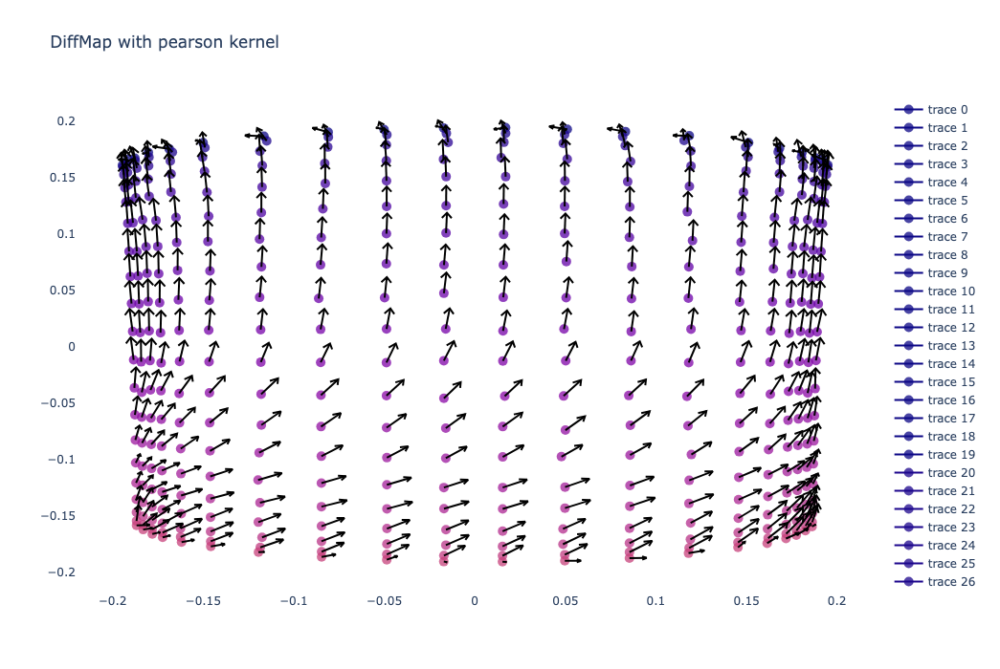

In [58]:
fig = go.Figure()
temp = X_df.iloc[indexes].reset_index(drop='True')
for i in range(temp.shape[0]):
    cl = temp.iloc[i]['color']
    fig.add_trace(
        go.Scatter(
            x=[temp.iloc[i]['diffMap1']],
            y=[temp.iloc[i]['diffMap2']],
            marker_color=temp.iloc[i]['color'],
            marker_size=10
            )
    )
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data', width=1000, height=700,
                  title="DiffMap with pearson kernel",
                  plot_bgcolor='white'
                 )
fig2 = ff.create_quiver(temp['diffMap1'], 
                        temp['diffMap2'], 
                        deltaX2_df.iloc[indexes][0], 
                        deltaX2_df.iloc[indexes][1], 
                        scale=0.02,
                        angle=np.pi/6,
                        #scaleratio=0.7, 
                        marker_color='black')
fig.add_traces(data = fig2.data)
fig.show()
fig.write_html("../plots/3D_vf_variation/pearson_kernel/2D_cylinder_diffMap_s2.html")

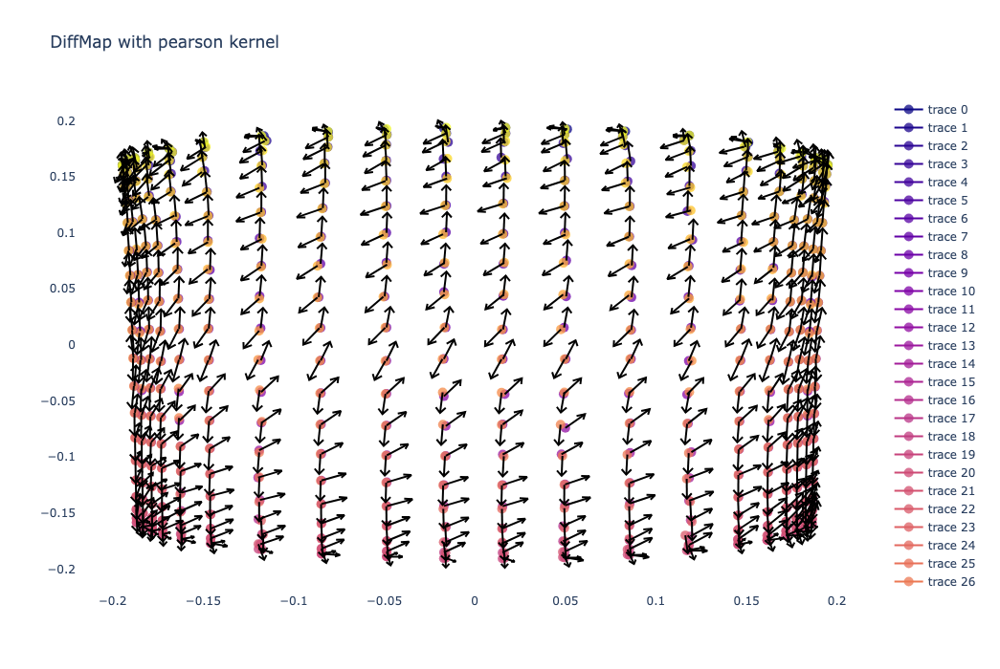

In [59]:
fig = go.Figure()
temp = X_df.reset_index(drop='True')
for i in range(temp.shape[0]):
    cl = temp.iloc[i]['color']
    fig.add_trace(
        go.Scatter(
            x=[temp.iloc[i]['diffMap1']],
            y=[temp.iloc[i]['diffMap2']],
            marker_color=temp.iloc[i]['color'],
            marker_size=10
            )
    )
fig.update_traces(marker=dict(colorscale='Plasma', opacity=0.75))
fig.update_layout(scene_aspectmode='data', width=1000, height=700,
                  title="DiffMap with pearson kernel",
                  plot_bgcolor='white'
                 )
fig2 = ff.create_quiver(temp['diffMap1'], 
                        temp['diffMap2'], 
                        deltaX2_df.iloc[:][0], 
                        deltaX2_df.iloc[:][1], 
                        scale=0.02,
                        angle=np.pi/6,
                        #scaleratio=0.7, 
                        marker_color='black')
fig.add_traces(data = fig2.data)
fig.show()
fig.write_html("../plots/3D_vf_variation/pearson_kernel/2D_cylinder_diffMap_both.html")